<a href="https://colab.research.google.com/github/robertophp/INT-JEPFS-V2-IL/blob/published/CasoCancelacionAnticipada_Por_Roberto_Menjivar_El_Salvador.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Cancelaciones anticipadas
Caso a resolver

In [ ]:
!pip install openpyxl

You should consider upgrading via the '/local_disk0/.ephemeral_nfs/envs/pythonEnv-ab476d57-351d-4079-a0ba-ed440bb4adac/bin/python -m pip install --upgrade pip' command.


In [ ]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
sns.set_theme(color_codes=True)

In [ ]:


dfsilver = pd.read_excel("/dbfs/FileStore/tables/Base_Precancelación_Perú_Ejercicio.xlsx")
dfsilver.head()

,DESC LINEA,TOTAL_VENTA,PRIMA,TIENE PRIMA,PRIMA/TOTAL VENTA,V_NOM_CADENA,N_NUMERO_PLAZO,N_CUOTAS_VENCIDAS,N_CUOTAS_PAGADAS,N_TASA,N_VALOR_CUOTA,BANCARIZADO,PLAN FINANCIERO,INGRESOS,AFECTACION,GENERO,ESTADO CIVIL,EDAD,TIPO,PRECANCELADO_CANCELADAS,Tienda,ZONA,PRECANCELADO
0,BLANCA,2057.75,0.0,No Prima,0.00,CARSA,12,0,12,61.25,224.53,Bancarizado B,Diamante 2,970.0,0.23,F,SOLTERO,72,Recurrente,1,CAR Ventanilla,LIMA CENTRO,1
1,MOTOS,17109.80,8000.0,Prima,0.47,CARSA,34,0,34,28.07,376.59,Recurrente OK,Diamante 1,860.0,0.44,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1
2,MOTOS,7777.85,0.0,No Prima,0.00,CARSA,30,0,30,34.49,371.61,Recurrente OK,Oro 1,860.0,0.43,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1
3,MARRON,4715.65,0.0,No Prima,0.00,CARSA,18,0,18,54.00,362.40,Recurrente OK,Oro 1,860.0,0.42,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1
4,BLANCA,1255.20,500.0,Prima,0.40,MARCIMEX,12,0,12,87.91,88.83,Bancarizado D,Plata 3,630.0,0.14,F,SOLTERO,74,Nuevo,1,MXM Aguaytia,PUCALLPA,1


In [ ]:
import pandas as pd
pd.DataFrame.iteritems = pd.DataFrame.items

In [ ]:
display(dfsilver)

DESC LINEA,TOTAL_VENTA,PRIMA,TIENE PRIMA,PRIMA/TOTAL VENTA,V_NOM_CADENA,N_NUMERO_PLAZO,N_CUOTAS_VENCIDAS,N_CUOTAS_PAGADAS,N_TASA,N_VALOR_CUOTA,BANCARIZADO,PLAN FINANCIERO,INGRESOS,AFECTACION,GENERO,ESTADO CIVIL,EDAD,TIPO,PRECANCELADO_CANCELADAS,Tienda,ZONA,PRECANCELADO
BLANCA,2057.75,0.0,No Prima,0.0,CARSA,12,0,12,61.25,224.53,Bancarizado B,Diamante 2,970.0,0.23,F,SOLTERO,72,Recurrente,1,CAR Ventanilla,LIMA CENTRO,1
MOTOS,17109.8,8000.0,Prima,0.47,CARSA,34,0,34,28.07,376.59,Recurrente OK,Diamante 1,860.0,0.44,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1
MOTOS,7777.85,0.0,No Prima,0.0,CARSA,30,0,30,34.49,371.61,Recurrente OK,Oro 1,860.0,0.43,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1
MARRON,4715.65,0.0,No Prima,0.0,CARSA,18,0,18,54.0,362.4,Recurrente OK,Oro 1,860.0,0.42,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1
BLANCA,1255.2,500.0,Prima,0.4,MARCIMEX,12,0,12,87.91,88.83,Bancarizado D,Plata 3,630.0,0.14,F,SOLTERO,74,Nuevo,1,MXM Aguaytia,PUCALLPA,1
MOTOS,7805.85,1000.0,Prima,0.13,CARSA,12,0,12,20.0,625.17,Bancarizado VIP 1,Diamante 1,700.0,0.89,F,SOLTERO,59,Recurrente,1,CAR Pucallpa,PUCALLPA,1
MOTOS,7541.5,3000.0,Prima,0.4,CARSA,22,1,22,79.59,345.02,No Bancarizado Predeterminado,Plata 3,903.0,0.38,M,SOLTERO,63,Nuevo,1,CAR Pucallpa,PUCALLPA,1
CREDICARSA TERCEROS DEALER,6087.0,0.0,No Prima,0.0,DEALER,24,0,24,76.0,433.61,Bancarizado OBSERVADO,Oro 2,2200.0,0.2,M,SOLTERO,57,Nuevo,1,DLR Pucallpa,DLR UCAYALI,1
CREDICARSA TERCEROS DEALER,6925.0,0.0,No Prima,0.0,DEALER,15,1,15,70.0,645.74,Bancarizado VIP 1,Diamante 1,840.0,0.77,M,SOLTERO,62,Nuevo,1,DLR Pucallpa,DLR UCAYALI,1
MOTOS,6971.56,4000.0,Prima,0.57,CARSA,3,0,3,50.25,1066.76,Bancarizado B,Oro 1,893.0,1.19,M,SOLTERO,52,Nuevo,1,CAR Pucallpa,PUCALLPA,1


Databricks data profile. Run in Databricks to view.

In [ ]:
dfsilver.shape

Out[43]: (82057, 23)

In [ ]:
#Variables con el formato correcto
dfsilver.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 82057 entries, 0 to 82056
Data columns (total 23 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   DESC LINEA               82057 non-null  object 
 1   TOTAL_VENTA              82057 non-null  float64
 2   PRIMA                    82057 non-null  float64
 3   TIENE PRIMA              82057 non-null  object 
 4   PRIMA/TOTAL VENTA        82057 non-null  float64
 5   V_NOM_CADENA             82057 non-null  object 
 6   N_NUMERO_PLAZO           82057 non-null  int64  
 7   N_CUOTAS_VENCIDAS        82057 non-null  int64  
 8   N_CUOTAS_PAGADAS         82057 non-null  int64  
 9   N_TASA                   82057 non-null  float64
 10  N_VALOR_CUOTA            82057 non-null  float64
 11  BANCARIZADO              82057 non-null  object 
 12  PLAN FINANCIERO          82057 non-null  object 
 13  INGRESOS                 82057 non-null  float64
 14  AFECTACION            

In [ ]:
#El numero de columnas con valores nulos son 0
dfsilver.isnull().sum()

Out[45]: DESC LINEA                 0
TOTAL_VENTA                0
PRIMA                      0
TIENE PRIMA                0
PRIMA/TOTAL VENTA          0
V_NOM_CADENA               0
N_NUMERO_PLAZO             0
N_CUOTAS_VENCIDAS          0
N_CUOTAS_PAGADAS           0
N_TASA                     0
N_VALOR_CUOTA              0
BANCARIZADO                0
PLAN FINANCIERO            0
INGRESOS                   0
AFECTACION                 0
GENERO                     0
ESTADO CIVIL               0
EDAD                       0
TIPO                       0
PRECANCELADO_CANCELADAS    0
Tienda                     0
ZONA                       0
PRECANCELADO               0
dtype: int64

In [ ]:
#Detecto alta cardinalidad en Tienda, evaluare si es necesario incluirla o no.
#Detecto alta cardinalidad en bancarizado, evaluare si es necesario delimitarla.
dfsilver.select_dtypes(include='object').nunique()

Out[46]: DESC LINEA          10
TIENE PRIMA          2
V_NOM_CADENA         4
BANCARIZADO         23
PLAN FINANCIERO     12
GENERO               2
ESTADO CIVIL         6
TIPO                 2
Tienda             144
ZONA                23
dtype: int64

In [ ]:
#No detectamos duplicados
numero_duplicados = dfsilver.duplicated().sum()
print(f'Número de filas duplicadas: {numero_duplicados}')

Número de filas duplicadas: 0


## Exploración y limpieza

In [ ]:
continuous_columns, categorical_columns = [], []
for x in dfsilver.columns:
    if dfsilver[x].dtypes=='object':
        categorical_columns.append(x)
    else:
        continuous_columns.append(x)

In [ ]:
continuous_columns

Out[49]: ['TOTAL_VENTA',
 'PRIMA',
 'PRIMA/TOTAL VENTA',
 'N_NUMERO_PLAZO',
 'N_CUOTAS_VENCIDAS',
 'N_CUOTAS_PAGADAS',
 'N_TASA',
 'N_VALOR_CUOTA',
 'INGRESOS',
 'AFECTACION',
 'EDAD',
 'PRECANCELADO_CANCELADAS',
 'PRECANCELADO']

## visualizacion

### Graficos Generales (visualizacion)

#### Variables categoricas

##### Barras

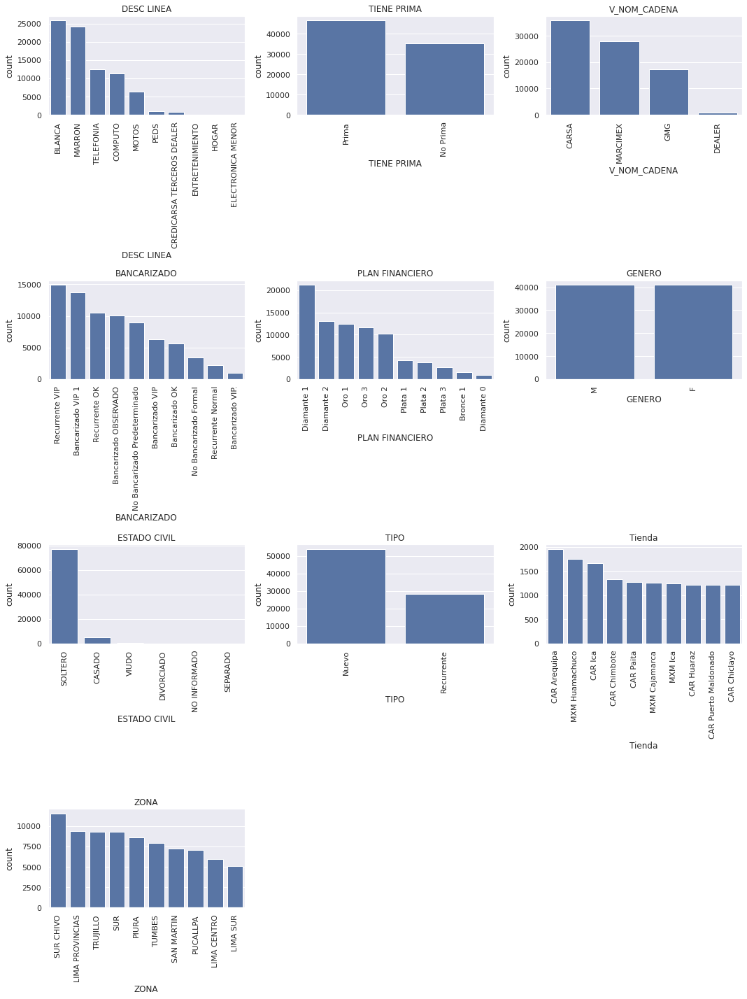

In [ ]:
# Creamos GRAFICAS CATEGORICAS con subplots
num_cols = len(categorical_columns)
num_rows = (num_cols + 2) // 3
fig, axs = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 5*num_rows))
axs = axs.flatten()


for i, var in enumerate(categorical_columns):
    top_values = dfsilver[var].value_counts().nlargest(10).index
    filtered_df = dfsilver[dfsilver[var].isin(top_values)]
    order = filtered_df[var].value_counts().index
    sns.countplot(x=var, data=filtered_df, ax=axs[i],order=order)
    axs[i].set_title(var)
    axs[i].tick_params(axis='x', rotation=90)

# quitamos extra empty plots
if num_cols < len(axs):
    for i in range(num_cols, len(axs)):
        fig.delaxes(axs[i])


fig.tight_layout()

plt.show()

Out[51]: <Axes: xlabel='BANCARIZADO'>

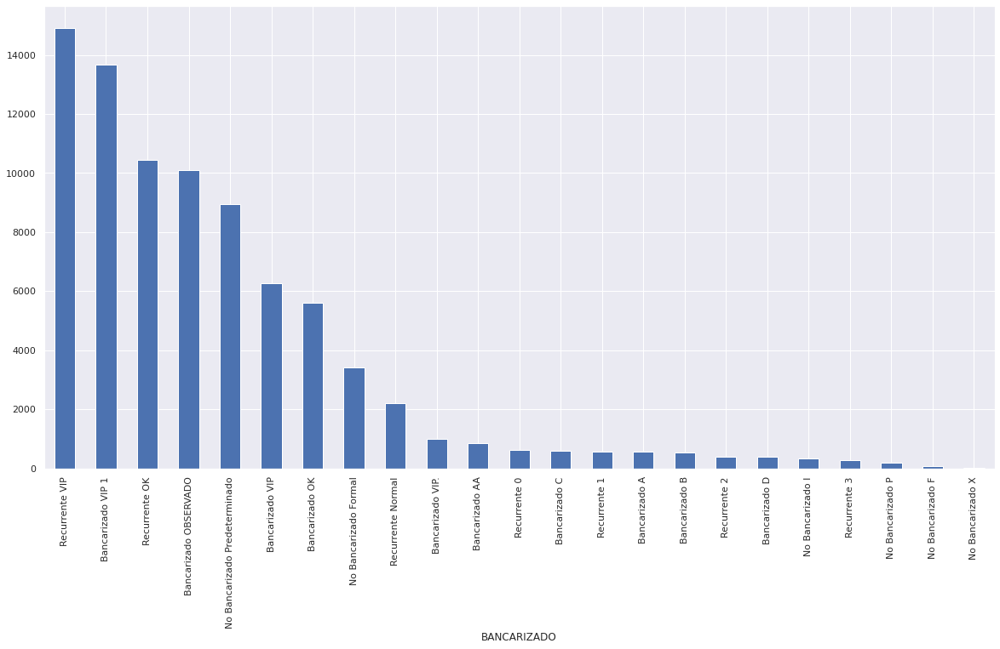

In [ ]:
#revisamos uno de los campos con mayor cardinalidad antes de borrarlo
plt.figure(figsize=(20,10))
dfsilver['BANCARIZADO'].value_counts().plot(kind='bar')

#### Variables numericas

##### Histograma

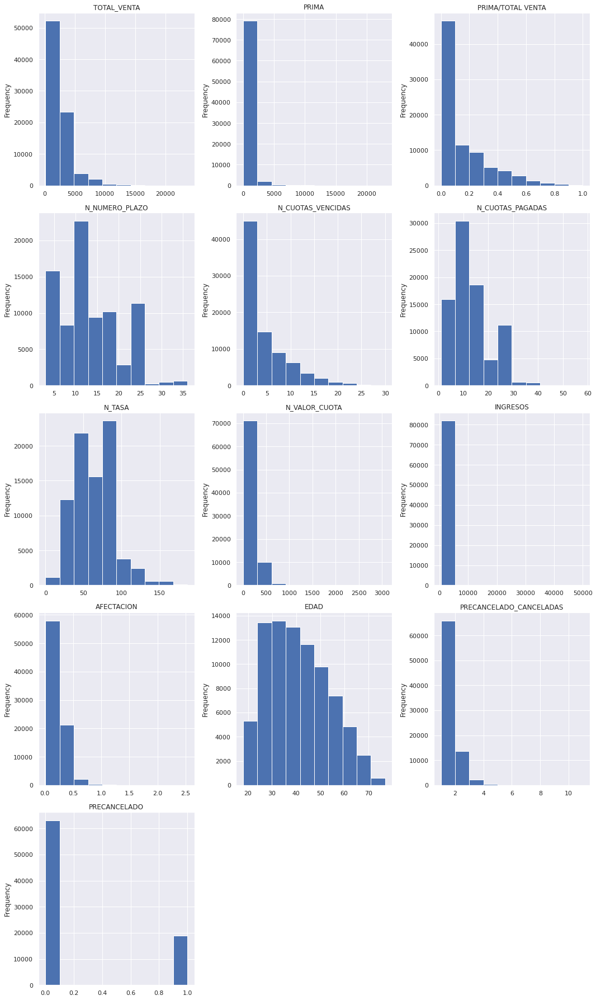

In [ ]:

num_cols = len(continuous_columns)
num_rows = (num_cols + 2) // 3  # To make sure there are enough rows for the subplots
fig, axs = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 5*num_rows))
axs = axs.flatten()

# Histogramas
for i, var in enumerate(continuous_columns):
    dfsilver[var].plot.hist(ax=axs[i])
    axs[i].set_title(var)


if num_cols < len(axs):
    for i in range(num_cols, len(axs)):
        fig.delaxes(axs[i])

fig.tight_layout()

# Show plot
plt.show()

##### Boxplot

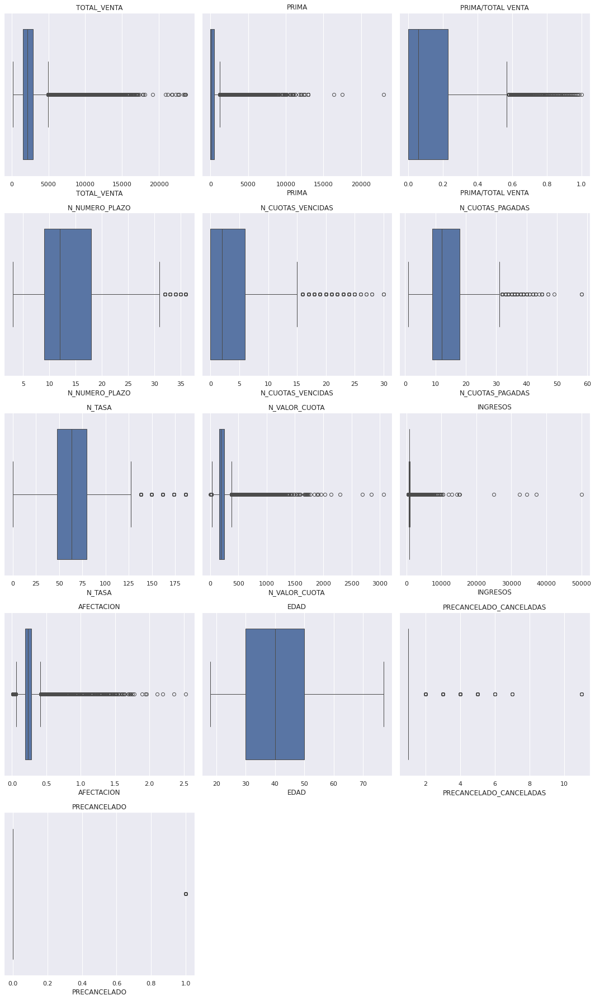

In [ ]:
num_cols = len(continuous_columns)
num_rows = (num_cols + 2) // 3
fig, axs = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 5*num_rows))
axs = axs.flatten()


for i, var in enumerate(continuous_columns):
    sns.boxplot(x=dfsilver[var], ax=axs[i])
    axs[i].set_title(var)


if num_cols < len(axs):
    for i in range(num_cols, len(axs)):
        fig.delaxes(axs[i])


fig.tight_layout()

# Show plot
plt.show()

### Graficos comparando Clientes con precancelamiento

#### Variables categoricas

##### Barras

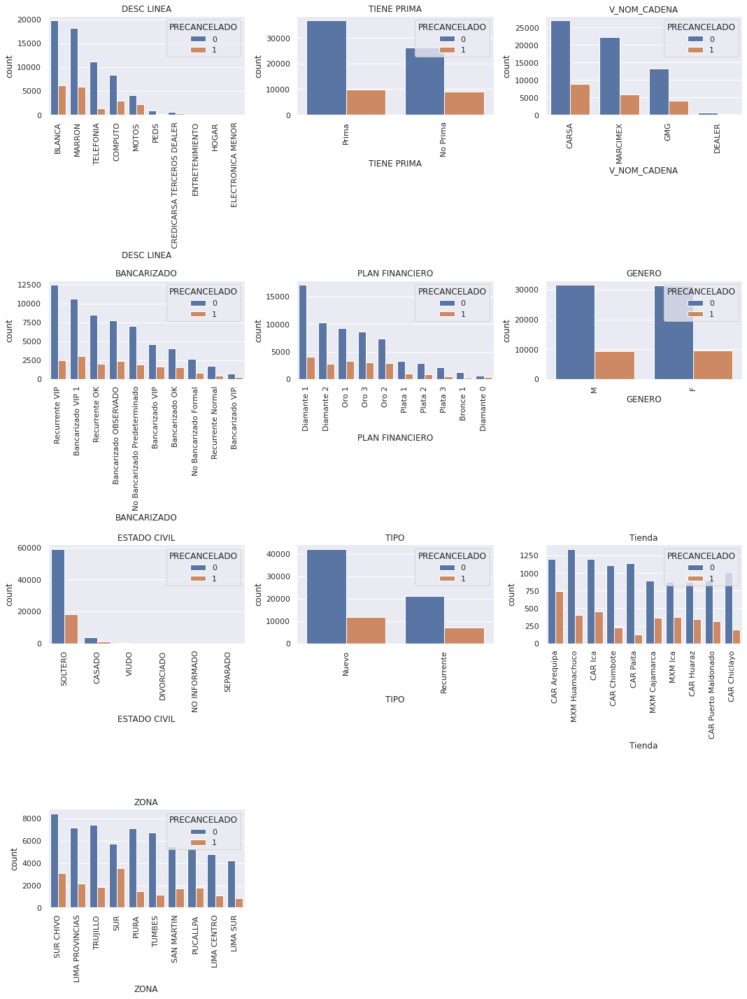

In [ ]:
# Creamos GRAFICAS CATEGORICAS con subplots
cat_vars = categorical_columns.copy()

num_cols = len(categorical_columns)
num_rows = (num_cols + 2) // 3
fig, axs = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 5*num_rows))
axs = axs.flatten()

if 'PRECANCELADO' in cat_vars:
    cat_vars.remove('PRECANCELADO')

for i, var in enumerate(cat_vars):
    top_values = dfsilver[var].value_counts().nlargest(10).index
    filtered_df = dfsilver[dfsilver[var].isin(top_values)]
    order = filtered_df[var].value_counts().index
    sns.countplot(x=var, data=filtered_df,hue='PRECANCELADO', ax=axs[i],order=order)
    axs[i].set_title(var)
    axs[i].tick_params(axis='x', rotation=90)

if num_cols < len(axs):
    for i in range(num_cols, len(axs)):
        fig.delaxes(axs[i])


fig.tight_layout()

plt.show()

##### Barras Apliadas

<command-3099107870519177>:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[i].set_xticklabels(dfsilver[var].unique(), rotation=90)
<command-3099107870519177>:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[i].set_xticklabels(dfsilver[var].unique(), rotation=90)
<command-3099107870519177>:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[i].set_xticklabels(dfsilver[var].unique(), rotation=90)
<command-3099107870519177>:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  axs[i].set_xticklabels(dfsilver[var].unique(), rotation=90)
<command-3099107870519177>:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after

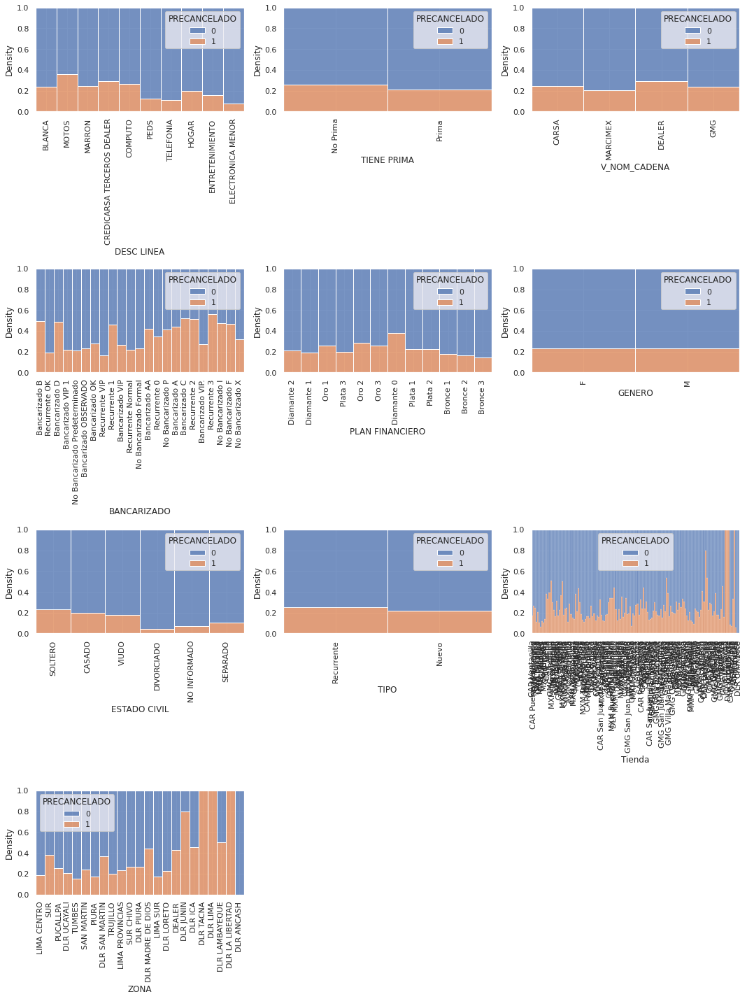

In [ ]:


num_cols = len(categorical_columns)
num_rows = (num_cols + 2) // 3
fig, axs = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 5*num_rows))
axs = axs.flatten()

for i, var in enumerate(categorical_columns):
    sns.histplot(x=var, hue='PRECANCELADO', data=dfsilver, ax=axs[i], multiple="fill", kde=False, element="bars", fill=True, stat='density')
    axs[i].set_xticklabels(dfsilver[var].unique(), rotation=90)
    axs[i].set_xlabel(var)

for i in range(num_cols, len(axs)):
    fig.delaxes(axs[i])

fig.tight_layout()

plt.show()

#### Variables Numericas

<command-3099107870519176>:19: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.tight_layout()
/databricks/python/lib/python3.9/site-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


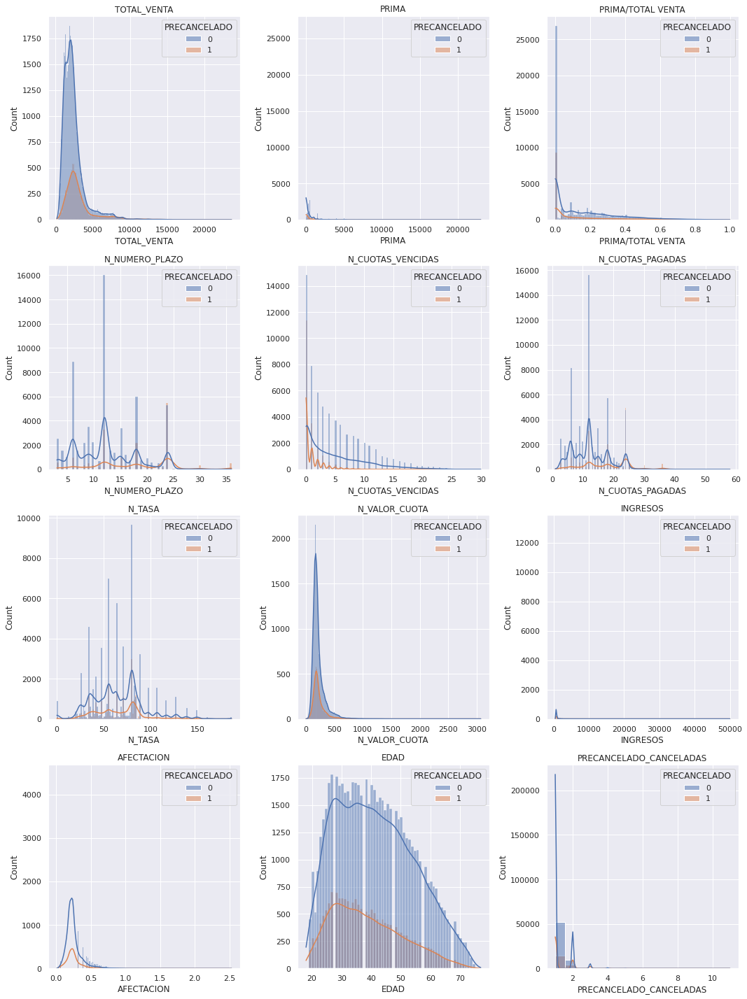

In [ ]:

num_vars = continuous_columns.copy()

if 'PRECANCELADO' in num_vars:
    num_vars.remove('PRECANCELADO')

num_cols = len(num_vars)
num_rows = (num_cols + 2) // 3
fig, axs = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 5*num_rows))
axs = axs.flatten()

for i, var in enumerate(num_vars):
    sns.histplot(data=dfsilver, x=var, hue='PRECANCELADO', kde=True, ax=axs[i])
    axs[i].set_title(var)

if num_cols < len(axs):
    for i in range(num_cols, len(axs)):
        fig.delaxes(axs[i])

fig.tight_layout()

plt.show()

## Procesamiento de la data

In [ ]:
df = dfsilver.copy()
df.head()

,DESC LINEA,TOTAL_VENTA,PRIMA,TIENE PRIMA,PRIMA/TOTAL VENTA,V_NOM_CADENA,N_NUMERO_PLAZO,N_CUOTAS_VENCIDAS,N_CUOTAS_PAGADAS,N_TASA,N_VALOR_CUOTA,BANCARIZADO,PLAN FINANCIERO,INGRESOS,AFECTACION,GENERO,ESTADO CIVIL,EDAD,TIPO,PRECANCELADO_CANCELADAS,Tienda,ZONA,PRECANCELADO
0,BLANCA,2057.75,0.0,No Prima,0.00,CARSA,12,0,12,61.25,224.53,Bancarizado B,Diamante 2,970.0,0.23,F,SOLTERO,72,Recurrente,1,CAR Ventanilla,LIMA CENTRO,1
1,MOTOS,17109.80,8000.0,Prima,0.47,CARSA,34,0,34,28.07,376.59,Recurrente OK,Diamante 1,860.0,0.44,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1
2,MOTOS,7777.85,0.0,No Prima,0.00,CARSA,30,0,30,34.49,371.61,Recurrente OK,Oro 1,860.0,0.43,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1
3,MARRON,4715.65,0.0,No Prima,0.00,CARSA,18,0,18,54.00,362.40,Recurrente OK,Oro 1,860.0,0.42,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1
4,BLANCA,1255.20,500.0,Prima,0.40,MARCIMEX,12,0,12,87.91,88.83,Bancarizado D,Plata 3,630.0,0.14,F,SOLTERO,74,Nuevo,1,MXM Aguaytia,PUCALLPA,1


### Ingenieria de variables

In [ ]:
df['FLAGBANCARIZADO']=(list(
                             map(lambda x: 1 if x in('Bancarizado VIP 1','Bancarizado OBSERVADO','Bancarizado VIP','Bancarizado OK','Bancarizado VIP.',
                                                     'Bancarizado AA','Bancarizado B','Bancarizado D')
                                 else 0, df['BANCARIZADO'])
                             )
)

In [ ]:
# Ratio que me indica la proporción de pagos realizados frente a los pagos vencidos
df['RATIOPAGOS'] = np.where(df['N_CUOTAS_VENCIDAS'] == 0,
                                      1,
                                      df['N_CUOTAS_PAGADAS'] / (df['N_CUOTAS_VENCIDAS']+df['N_CUOTAS_PAGADAS']))

In [ ]:
display(df)

DESC LINEA,TOTAL_VENTA,PRIMA,TIENE PRIMA,PRIMA/TOTAL VENTA,V_NOM_CADENA,N_NUMERO_PLAZO,N_CUOTAS_VENCIDAS,N_CUOTAS_PAGADAS,N_TASA,N_VALOR_CUOTA,BANCARIZADO,PLAN FINANCIERO,INGRESOS,AFECTACION,GENERO,ESTADO CIVIL,EDAD,TIPO,PRECANCELADO_CANCELADAS,Tienda,ZONA,PRECANCELADO,FLAGBANCARIZADO,RATIOPAGOS
BLANCA,2057.75,0.0,No Prima,0.0,CARSA,12,0,12,61.25,224.53,Bancarizado B,Diamante 2,970.0,0.23,F,SOLTERO,72,Recurrente,1,CAR Ventanilla,LIMA CENTRO,1,1,1.0
MOTOS,17109.8,8000.0,Prima,0.47,CARSA,34,0,34,28.07,376.59,Recurrente OK,Diamante 1,860.0,0.44,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1,0,1.0
MOTOS,7777.85,0.0,No Prima,0.0,CARSA,30,0,30,34.49,371.61,Recurrente OK,Oro 1,860.0,0.43,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1,0,1.0
MARRON,4715.65,0.0,No Prima,0.0,CARSA,18,0,18,54.0,362.4,Recurrente OK,Oro 1,860.0,0.42,M,SOLTERO,58,Recurrente,4,CAR Puerto Maldonado,SUR,1,0,1.0
BLANCA,1255.2,500.0,Prima,0.4,MARCIMEX,12,0,12,87.91,88.83,Bancarizado D,Plata 3,630.0,0.14,F,SOLTERO,74,Nuevo,1,MXM Aguaytia,PUCALLPA,1,1,1.0
MOTOS,7805.85,1000.0,Prima,0.13,CARSA,12,0,12,20.0,625.17,Bancarizado VIP 1,Diamante 1,700.0,0.89,F,SOLTERO,59,Recurrente,1,CAR Pucallpa,PUCALLPA,1,1,1.0
MOTOS,7541.5,3000.0,Prima,0.4,CARSA,22,1,22,79.59,345.02,No Bancarizado Predeterminado,Plata 3,903.0,0.38,M,SOLTERO,63,Nuevo,1,CAR Pucallpa,PUCALLPA,1,0,0.9565217391304348
CREDICARSA TERCEROS DEALER,6087.0,0.0,No Prima,0.0,DEALER,24,0,24,76.0,433.61,Bancarizado OBSERVADO,Oro 2,2200.0,0.2,M,SOLTERO,57,Nuevo,1,DLR Pucallpa,DLR UCAYALI,1,1,1.0
CREDICARSA TERCEROS DEALER,6925.0,0.0,No Prima,0.0,DEALER,15,1,15,70.0,645.74,Bancarizado VIP 1,Diamante 1,840.0,0.77,M,SOLTERO,62,Nuevo,1,DLR Pucallpa,DLR UCAYALI,1,1,0.9375
MOTOS,6971.56,4000.0,Prima,0.57,CARSA,3,0,3,50.25,1066.76,Bancarizado B,Oro 1,893.0,1.19,M,SOLTERO,52,Nuevo,1,CAR Pucallpa,PUCALLPA,1,1,1.0


In [ ]:
# Eliminames variables


df.drop(columns = ['ESTADO CIVIL', 'Tienda', 'BANCARIZADO','PRIMA','N_CUOTAS_PAGADAS','N_CUOTAS_VENCIDAS'], inplace=True)

In [ ]:
df.columns

Out[62]: Index(['DESC LINEA', 'TOTAL_VENTA', 'TIENE PRIMA', 'PRIMA/TOTAL VENTA',
       'V_NOM_CADENA', 'N_NUMERO_PLAZO', 'N_TASA', 'N_VALOR_CUOTA',
       'PLAN FINANCIERO', 'INGRESOS', 'AFECTACION', 'GENERO', 'EDAD', 'TIPO',
       'PRECANCELADO_CANCELADAS', 'ZONA', 'PRECANCELADO', 'FLAGBANCARIZADO',
       'RATIOPAGOS'],
      dtype='object')

##### Graficando nuevas variables

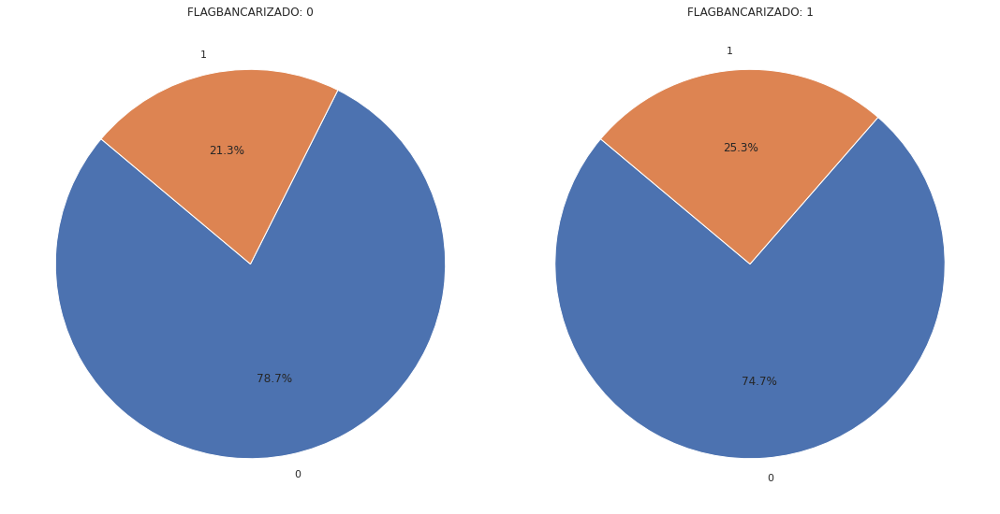

In [ ]:
grouped = df.groupby(['FLAGBANCARIZADO', 'PRECANCELADO']).size().unstack(fill_value=0)


fig, axes = plt.subplots(1, grouped.shape[0], figsize=(15, 8))

# Creamos gráficos de pastel para cada categoría de FLAGBANCARIZADO
for i, (flag, counts) in enumerate(grouped.iterrows()):
    axes[i].pie(counts, labels=counts.index, autopct='%1.1f%%', startangle=140)
    axes[i].set_title(f'FLAGBANCARIZADO: {flag}')

plt.tight_layout()
plt.show()


Out[64]: <Axes: xlabel='RATIOPAGOS', ylabel='Count'>

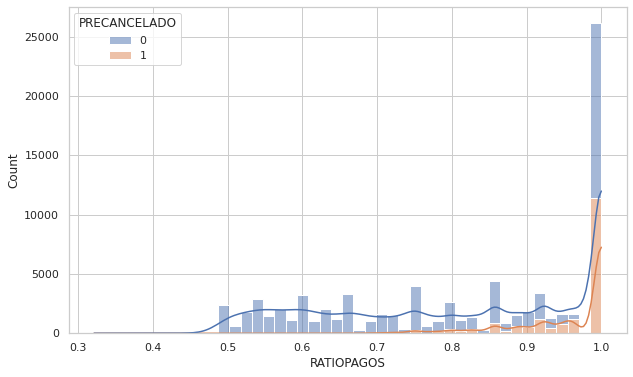

In [ ]:
sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))

# Creamos histograma para el ratio de pago dejando PRECANCELADO COMO hue
sns.histplot(data=df, x='RATIOPAGOS', hue='PRECANCELADO', kde=True, multiple="stack")

### Encoder

In [ ]:
from sklearn import preprocessing
#decidi label encoder por simplicidad, elimine previamente columnas con alta cardinalidad y aproveche algunas para crear variables asi que considero que no afectara

for col in df.select_dtypes(include=['object']).columns:


    label_encoder = preprocessing.LabelEncoder()
    label_encoder.fit(df[col].unique())
    df[col] = label_encoder.transform(df[col])

    # Print
    print(f"{col}: {df[col].unique()}")

DESC LINEA: [0 7 6 2 1 8 9 5 4 3]
TIENE PRIMA: [0 1]
V_NOM_CADENA: [0 3 1 2]
PLAN FINANCIERO: [ 5  4  6 11  7  8  3  9 10  0  1  2]
GENERO: [0 1]
TIPO: [1 0]
ZONA: [13 19 17 12 22 18 16 10 21 14 20  9  8 15  7  0  3  2 11  6  5  4  1]


### Correlacion

Out[66]: <Axes: >

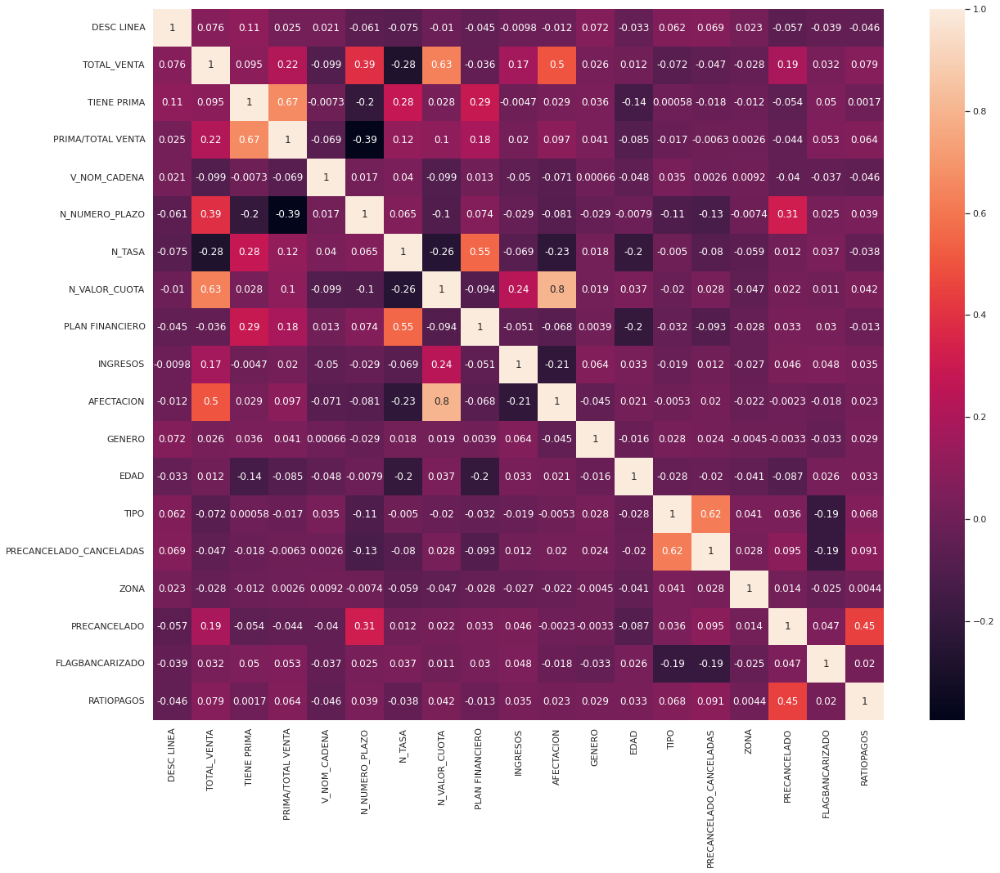

In [ ]:
#correlaciones bajas
plt.figure(figsize=(20, 16))
sns.heatmap(df.corr(), fmt='.2g', annot=True)

### Manejo de Outlier

In [ ]:
continuous_columns2 = []
for x in df.columns:
    if df[x].dtypes!='object':
        continuous_columns2.append(x)

continuous_columns2

Out[67]: ['DESC LINEA',
 'TOTAL_VENTA',
 'TIENE PRIMA',
 'PRIMA/TOTAL VENTA',
 'V_NOM_CADENA',
 'N_NUMERO_PLAZO',
 'N_TASA',
 'N_VALOR_CUOTA',
 'PLAN FINANCIERO',
 'INGRESOS',
 'AFECTACION',
 'GENERO',
 'EDAD',
 'TIPO',
 'PRECANCELADO_CANCELADAS',
 'ZONA',
 'PRECANCELADO',
 'FLAGBANCARIZADO',
 'RATIOPAGOS']

In [ ]:
def removeOutliers (dat, columnName):
    q4 = dat[columnName].quantile(.99)
    dat[columnName]=list(map(lambda x: q4 if x > q4 else x ,dat[columnName]))

    return dat

In [ ]:
#No eliminaremos datos solo definiremos un techo maximo, de esta manera los maximos seguiran siendo maximos sin afectar a la distribucion de los datos y sesgar el modelo
varoutlier= ['INGRESOS','N_VALOR_CUOTA','AFECTACION']

for var in varoutlier:
    dftransformado = removeOutliers(df, var)

In [ ]:
dftransformado[varoutlier].describe()

,INGRESOS,N_VALOR_CUOTA,AFECTACION
count,82057.000000,82057.000000,82057.000000
mean,929.290558,218.068480,0.247179
std,405.712469,99.462368,0.107679
min,500.000000,5.910000,0.010000
25%,800.000000,157.960000,0.190000
50%,850.000000,191.990000,0.230000
75%,893.000000,245.130000,0.280000
max,3344.180000,636.129600,0.710000


### Escalado

In [ ]:
scaler = MinMaxScaler()
dfscaled = scaler.fit_transform(dftransformado)
dfscaled = pd.DataFrame(dfscaled, columns=dftransformado.columns)
dfscaled

,DESC LINEA,TOTAL_VENTA,TIENE PRIMA,PRIMA/TOTAL VENTA,V_NOM_CADENA,N_NUMERO_PLAZO,N_TASA,N_VALOR_CUOTA,PLAN FINANCIERO,INGRESOS,AFECTACION,GENERO,EDAD,TIPO,PRECANCELADO_CANCELADAS,ZONA,PRECANCELADO,FLAGBANCARIZADO,RATIOPAGOS
0,0.000000,0.080764,0.0,0.00,0.0,0.272727,0.328471,0.346895,0.454545,0.165250,0.314286,0.0,0.915254,1.0,0.0,0.590909,1.0,1.0,1.0
1,0.777778,0.721922,1.0,0.47,0.0,0.939394,0.150534,0.588176,0.363636,0.126574,0.614286,1.0,0.677966,1.0,0.3,0.863636,1.0,0.0,1.0
2,0.777778,0.324418,0.0,0.00,0.0,0.818182,0.184963,0.580274,0.545455,0.126574,0.600000,1.0,0.677966,1.0,0.3,0.863636,1.0,0.0,1.0
3,0.666667,0.193980,0.0,0.00,0.0,0.454545,0.289591,0.565660,0.545455,0.126574,0.585714,1.0,0.677966,1.0,0.3,0.863636,1.0,0.0,1.0
4,0.000000,0.046579,1.0,0.40,1.0,0.272727,0.471443,0.131573,1.000000,0.045707,0.185714,0.0,0.949153,0.0,0.0,0.772727,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82052,0.111111,0.032467,1.0,0.43,0.0,0.000000,0.222556,0.286122,0.272727,0.540648,0.114286,0.0,0.254237,0.0,0.0,0.909091,0.0,1.0,1.0
82053,0.111111,0.070675,1.0,0.11,0.0,0.000000,0.222556,0.904875,0.272727,0.210957,0.728571,1.0,0.355932,0.0,0.0,0.863636,0.0,0.0,1.0
82054,0.000000,0.085056,0.0,0.00,0.0,0.212121,0.349922,0.130288,0.454545,0.239879,0.085714,0.0,0.457627,0.0,0.0,0.863636,0.0,1.0,1.0
82055,0.000000,0.140970,1.0,0.29,1.0,0.000000,0.222556,1.000000,0.272727,0.140638,1.000000,0.0,0.711864,0.0,0.0,0.772727,0.0,0.0,1.0


In [ ]:
display(dfscaled)

DESC LINEA,TOTAL_VENTA,TIENE PRIMA,PRIMA/TOTAL VENTA,V_NOM_CADENA,N_NUMERO_PLAZO,N_TASA,N_VALOR_CUOTA,PLAN FINANCIERO,INGRESOS,AFECTACION,GENERO,EDAD,TIPO,PRECANCELADO_CANCELADAS,ZONA,PRECANCELADO,FLAGBANCARIZADO,RATIOPAGOS
0.0,0.08076425849844632,0.0,0.0,0.0,0.2727272727272727,0.32847106773207485,0.3468949553457238,0.4545454545454546,0.16524973806158544,0.3142857142857143,0.0,0.9152542372881356,1.0,0.0,0.5909090909090909,1.0,1.0,0.9999999999999999
0.7777777777777777,0.7219222749703426,1.0,0.47,0.0,0.9393939393939393,0.15053359789778517,0.5881759310564124,0.36363636363636365,0.12657426745142714,0.6142857142857143,1.0,0.6779661016949152,1.0,0.30000000000000004,0.8636363636363636,1.0,0.0,0.9999999999999999
0.7777777777777777,0.32441797809284667,0.0,0.0,0.0,0.8181818181818182,0.1849627285890492,0.5802739235656902,0.5454545454545454,0.12657426745142714,0.6000000000000001,1.0,0.6779661016949152,1.0,0.30000000000000004,0.8636363636363636,1.0,0.0,0.9999999999999999
0.6666666666666666,0.19398032488014536,0.0,0.0,0.0,0.4545454545454545,0.2895908188984823,0.5656599699533302,0.5454545454545454,0.12657426745142714,0.5857142857142857,1.0,0.6779661016949152,1.0,0.30000000000000004,0.8636363636363636,1.0,0.0,0.9999999999999999
0.0,0.046578790996044964,1.0,0.4,1.0,0.2727272727272727,0.47144312758084406,0.13157318496600226,1.0,0.04570737435745981,0.18571428571428572,0.0,0.9491525423728813,0.0,0.0,0.7727272727272727,1.0,1.0,0.9999999999999999
0.7777777777777777,0.3256106677571258,1.0,0.13,0.0,0.2727272727272727,0.10725585885128974,0.9826098712258389,0.36363636363636365,0.07031903747301507,1.0,0.0,0.6949152542372881,1.0,0.0,0.7727272727272727,1.0,1.0,0.9999999999999999
0.7777777777777777,0.3143503994445474,1.0,0.4,0.0,0.5757575757575758,0.42682469029870757,0.5380822811604079,1.0,0.14169286050812535,0.5285714285714287,1.0,0.7627118644067796,0.0,0.0,0.7727272727272727,1.0,0.0,0.9359267734553774
0.2222222222222222,0.252394430991189,0.0,0.0,0.3333333333333333,0.6363636363636364,0.407572263634901,0.6786523300766905,0.6363636363636364,0.597711818520628,0.27142857142857146,1.0,0.6610169491525424,0.0,0.0,0.5454545454545454,1.0,1.0,0.9999999999999999
0.2222222222222222,0.2880899288006867,0.0,0.0,0.3333333333333333,0.36363636363636365,0.3753955059795141,0.9999999999999999,0.36363636363636365,0.11954236370412563,1.0,1.0,0.7457627118644068,0.0,0.0,0.5454545454545454,1.0,1.0,0.9078947368421052
0.7777777777777777,0.2900732013281452,1.0,0.57,0.0,0.0,0.2694803453638655,0.9999999999999999,0.5454545454545454,0.13817690863447463,1.0,1.0,0.576271186440678,0.0,0.0,0.7727272727272727,1.0,1.0,0.9999999999999999


Databricks data profile. Run in Databricks to view.

In [ ]:
dfscaled['PRECANCELADO'].value_counts()

Out[73]: PRECANCELADO
0.0    63049
1.0    19008
Name: count, dtype: int64

## Modelado

Trabajremos con Arboles, dado que son mas sencillos de comprender y son versatiles con bases imbalanceadas

In [ ]:
X = dfscaled.drop('PRECANCELADO', axis=1)
y = dfscaled['PRECANCELADO']


from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2,random_state=0)

### DecisionTreeClassifier

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
dtree = DecisionTreeClassifier(class_weight='balanced')


param_grid = {
    'max_depth': [3, 4, 5, 6, 7, 8],
    'min_samples_split': [2, 3, 4],
    'min_samples_leaf': [1, 2, 3, 4],
    'random_state': [0, 42]
}

# grid search con 5-fold cross-validation
grid_search = GridSearchCV(dtree, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# mejores hyperparameters
print(grid_search.best_params_)

{'max_depth': 8, 'min_samples_leaf': 1, 'min_samples_split': 2, 'random_state': 42}


In [ ]:
from sklearn.tree import DecisionTreeClassifier
dtree = DecisionTreeClassifier(max_depth = 8, min_samples_leaf = 1, min_samples_split = 3, random_state = 0, class_weight='balanced')
dtree.fit(X_train, y_train)

DecisionTreeClassifier(class_weight='balanced', max_depth=8,
 min_samples_split=3, random_state=0) In a Jupyter environment, please rerun this cell to show the HTML representation or trust the notebook. On GitHub, the HTML representation is unable to render, please try loading this page with nbviewer.org. DecisionTreeClassifier DecisionTreeClassifier(class_weight='balanced', max_depth=8,
 min_samples_split=3, random_state=0)

In [ ]:
y_pred = dtree.predict(X_test)
print("Accuracy Score :", round(accuracy_score(y_test, y_pred)*100 ,2), "%")

Accuracy Score : 75.58 %


In [ ]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, jaccard_score, log_loss

print('F-1 Score : ',(f1_score(y_test, y_pred, average='micro')))
print('Precision Score : ',(precision_score(y_test, y_pred, average='micro')))
print('Recall Score : ',(recall_score(y_test, y_pred, average='micro')))
print('Jaccard Score : ',(jaccard_score(y_test, y_pred, average='micro')))
print('Log Loss : ',(log_loss(y_test, y_pred)))

F-1 Score :  0.7557884474774555
Precision Score :  0.7557884474774555
Recall Score :  0.7557884474774555
Jaccard Score :  0.6074436826640548
Log Loss :  8.802276552740771


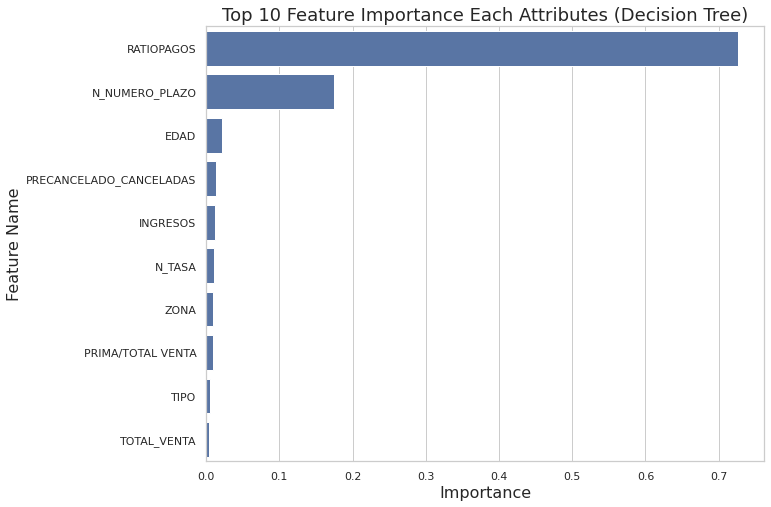

In [ ]:
#me hacen mucho sentido las variables de importancia, ratio de pago es una variable de peso ya que al ver la correlación con la variable de PRECANDELADO, se puede ver que el pago es muy importante ya que tenemos un gran numero de clientes con pago al dia, nunca se retrasan y aun asi deciden anticiparse su pago. El plazo largo siempre tiende a cancelarse antes.


imp_df = pd.DataFrame({
    "Feature Name": X_train.columns,
    "Importance": dtree.feature_importances_
})
fi = imp_df.sort_values(by="Importance", ascending=False)

fi2 = fi.head(10)
plt.figure(figsize=(10,8))
sns.barplot(data=fi2, x='Importance', y='Feature Name')
plt.title('Top 10 Feature Importance Each Attributes (Decision Tree)', fontsize=18)
plt.xlabel ('Importance', fontsize=16)
plt.ylabel ('Feature Name', fontsize=16)
plt.show()

Out[82]: Text(0.5, 1.0, 'Accuracy Score for Decision Tree: 0.7557884474774555')

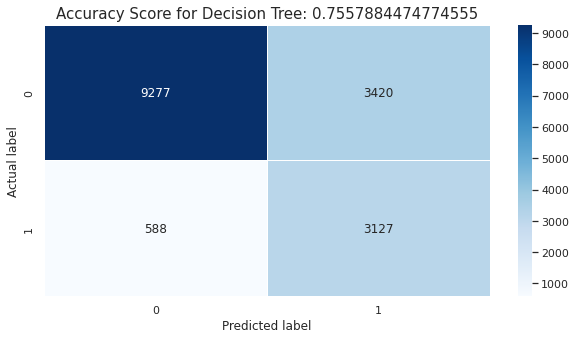

In [ ]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(10,5))
sns.heatmap(data=cm,linewidths=.5, annot=True,  cmap = 'Blues', fmt = 'd')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Accuracy Score for Decision Tree: {0}'.format(dtree.score(X_test, y_test))
plt.title(all_sample_title, size = 15)

Out[83]: <matplotlib.legend.Legend at 0x7f1447aef100>

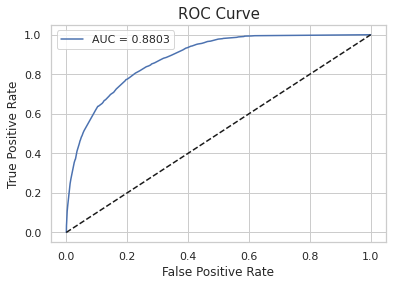

In [ ]:
#Un AUC de 0.88 es bastante bueno, sabe distinguir bien entre 1 y 0
from sklearn.metrics import roc_curve, roc_auc_score
y_pred_proba = dtree.predict_proba(X_test)[:][:,1]

df_actual_predicted = pd.concat([pd.DataFrame(np.array(y_test), columns=['y_actual']), pd.DataFrame(y_pred_proba, columns=['y_pred_proba'])], axis=1)
df_actual_predicted.index = y_test.index

fpr, tpr, tr = roc_curve(df_actual_predicted['y_actual'], df_actual_predicted['y_pred_proba'])
auc = roc_auc_score(df_actual_predicted['y_actual'], df_actual_predicted['y_pred_proba'])

plt.plot(fpr, tpr, label='AUC = %0.4f' %auc)
plt.plot(fpr, fpr, linestyle = '--', color='k')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve', size = 15)
plt.legend()

### Random Forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
rfc = RandomForestClassifier(class_weight='balanced')
param_grid = {
    'n_estimators': [100, 200],
    'max_depth': [None, 5, 10],
    'max_features': ['sqrt', 'log2', None],
    'random_state': [0, 42]
}


grid_search = GridSearchCV(rfc, param_grid, cv=5)
grid_search.fit(X_train, y_train)

print(grid_search.best_params_)

{'max_depth': None, 'max_features': 'sqrt', 'n_estimators': 200, 'random_state': 42}


In [ ]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(random_state=42, max_depth=None, max_features='sqrt', n_estimators=200, class_weight='balanced')
rfc.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', n_estimators=200,
 random_state=42) In a Jupyter environment, please rerun this cell to show the HTML representation or trust the notebook. On GitHub, the HTML representation is unable to render, please try loading this page with nbviewer.org. RandomForestClassifier RandomForestClassifier(class_weight='balanced', n_estimators=200,
 random_state=42)

In [ ]:
y_pred = rfc.predict(X_test)
print("Accuracy Score :", round(accuracy_score(y_test, y_pred)*100 ,2), "%")

Accuracy Score : 85.64 %


In [ ]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, jaccard_score, log_loss

print('F-1 Score : ',(f1_score(y_test, y_pred, average='micro')))
print('Precision Score : ',(precision_score(y_test, y_pred, average='micro')))
print('Recall Score : ',(recall_score(y_test, y_pred, average='micro')))
print('Jaccard Score : ',(jaccard_score(y_test, y_pred, average='micro')))
print('Log Loss : ',(log_loss(y_test, y_pred)))

F-1 Score :  0.856446502559103
Precision Score :  0.856446502559103
Recall Score :  0.856446502559103
Jaccard Score :  0.7489343563512362
Log Loss :  5.174192504555204


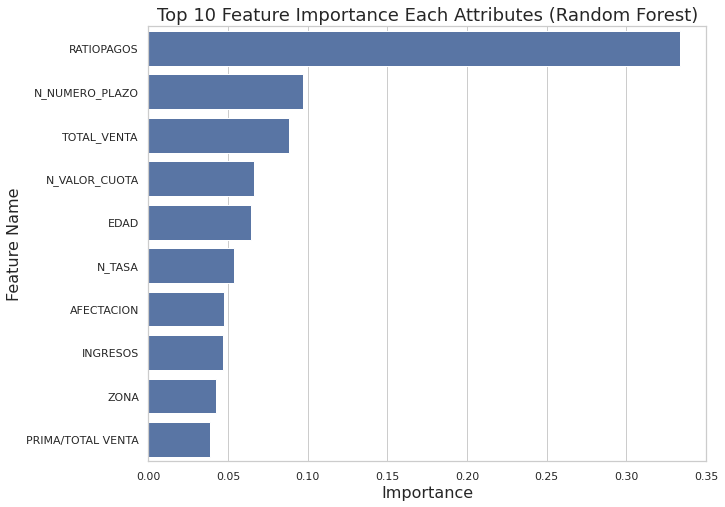

In [ ]:
imp_df = pd.DataFrame({
    "Feature Name": X_train.columns,
    "Importance": rfc.feature_importances_
})
fi = imp_df.sort_values(by="Importance", ascending=False)

fi2 = fi.head(10)
plt.figure(figsize=(10,8))
sns.barplot(data=fi2, x='Importance', y='Feature Name')
plt.title('Top 10 Feature Importance Each Attributes (Random Forest)', fontsize=18)
plt.xlabel ('Importance', fontsize=16)
plt.ylabel ('Feature Name', fontsize=16)
plt.show()

Out[92]: <matplotlib.legend.Legend at 0x7f1447a3f7f0>

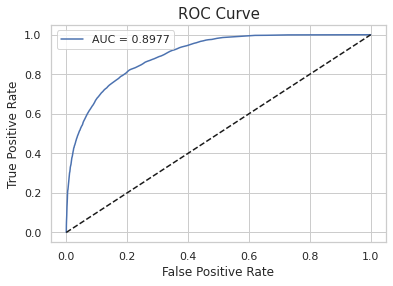

In [ ]:
from sklearn.metrics import roc_curve, roc_auc_score
y_pred_proba = rfc.predict_proba(X_test)[:][:,1]

df_actual_predicted = pd.concat([pd.DataFrame(np.array(y_test), columns=['y_actual']), pd.DataFrame(y_pred_proba, columns=['y_pred_proba'])], axis=1)
df_actual_predicted.index = y_test.index

fpr, tpr, tr = roc_curve(df_actual_predicted['y_actual'], df_actual_predicted['y_pred_proba'])
auc = roc_auc_score(df_actual_predicted['y_actual'], df_actual_predicted['y_pred_proba'])

plt.plot(fpr, tpr, label='AUC = %0.4f' %auc)
plt.plot(fpr, fpr, linestyle = '--', color='k')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve', size = 15)
plt.legend()